<a href="https://colab.research.google.com/github/smccracken13/DataScienceCareerTrack/blob/main/Zestimate_EDA_(2016_only).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Exploratory Data Analysis
https://www.kaggle.com/competitions/zillow-prize-1

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files

In [2]:
files.upload()
print()

Saving zillow16.csv to zillow16.csv


{'zillow16.csv': b'\xef\xbb\xbf,parcelid,logerror,transactiondate,transaction_year,transaction_month,transaction_day,transaction_quarter,aircon,architecture,basementsqft,bathroomcnt,bedroomcnt,framing,quality,calculatedbathnbr,deck,entry_floor_sqft,home_sqft,living_sqft,perimeter_sqft,total_sqft,base_sqft,fips,fireplacecnt,fullbathcnt,garagecarcnt,garage_sqft,has_spa,heating,latitude,longitude,lot_sqft,poolcnt,poolsizesum,pool_with_spa,pool_without_spa,land_use_code,county_land_use_code,zoning_code,rawcensustractandblock,city,county,neighborhood,zipcode,roomcnt,storytypeid,threequarterbathnbr,material,unitcnt,patio_sqft,shed_sqft,yearbuilt,numberofstories,fireplaceflag,tav_built,tax_assessed_value,assessmentyear,tav_land,property_tax,taxdelinquencyflag,taxdelinquencyyear,censustractandblock\n0,11016594,0.0276,2016-01-01,2016,1,1,1,1.0,,,2.0,3.0,,4.0,2.0,,,1684.0,1684.0,,,,6037.0,,2.0,,,,2.0,34280990.0,-118488536.0,7528.0,,,,,0100,261.0,LARS,60371066.461001,12447.0,3101.0,31817.0,96370.

In [3]:
df16 = pd.read_csv('zillow16.csv', low_memory=False)

In [4]:
df16['transactiondate']=pd.to_datetime(df16.transactiondate)

# Explore Log Error

In [5]:
print('Log Error statistics')
print(df16.logerror.describe())

Log Error statistics
count    90275.000000
mean         0.011457
std          0.161079
min         -4.605000
25%         -0.025300
50%          0.006000
75%          0.039200
max          4.737000
Name: logerror, dtype: float64


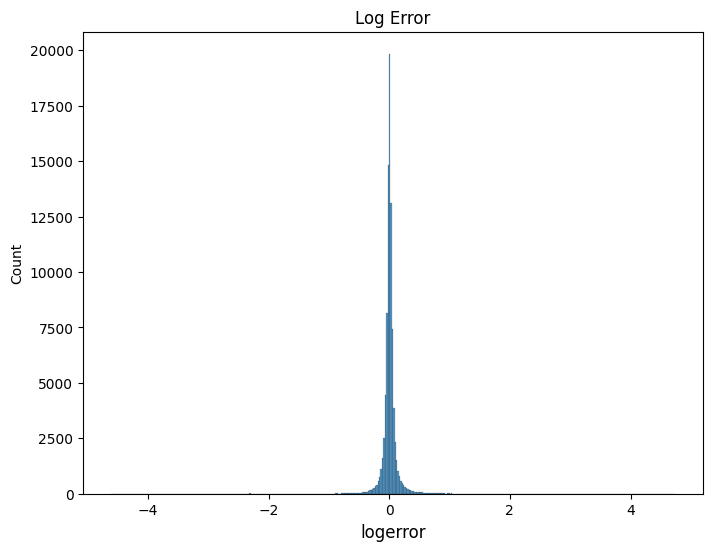

In [6]:
# Log Error Histogram
plt.figure(figsize=(8,6))
sns.histplot(df16.logerror.values, bins=400)
plt.xlabel('logerror', fontsize=12)
plt.title('Log Error')
plt.show()

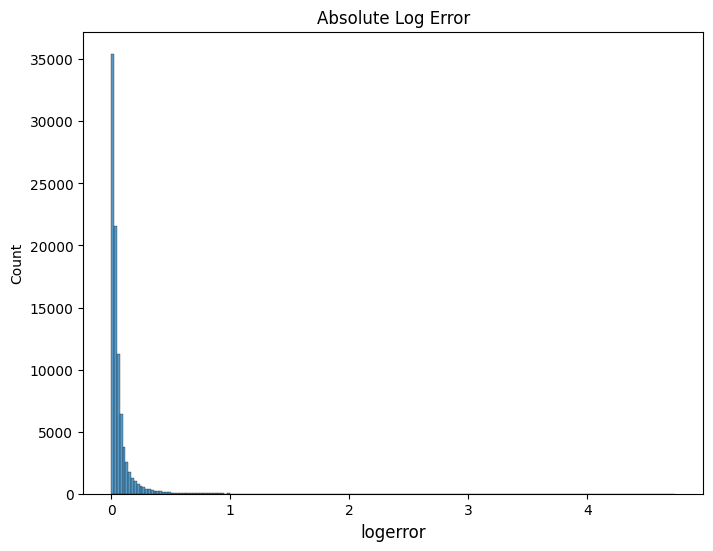

In [7]:
# Absolute Log Error Histogram
plt.figure(figsize=(8,6))
sns.histplot(abs(df16.logerror.values), bins=200)
plt.xlabel('logerror', fontsize=12)
plt.title('Absolute Log Error')
plt.show()

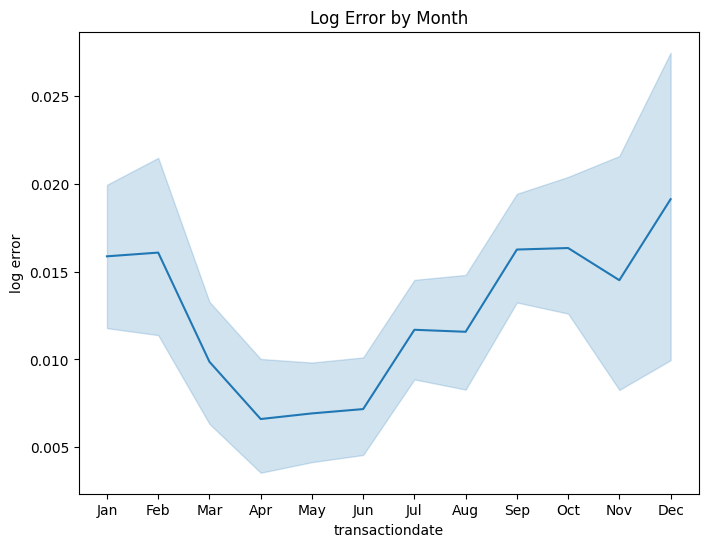

In [8]:
# logerror over time
plt.figure(figsize=(8,6))
g = sns.lineplot(x=df16.transactiondate.dt.month, y=df16.logerror.values)
plt.ylabel('log error')
plt.title('Log Error by Month')
plt.xticks(range(1,13))
g.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.show()

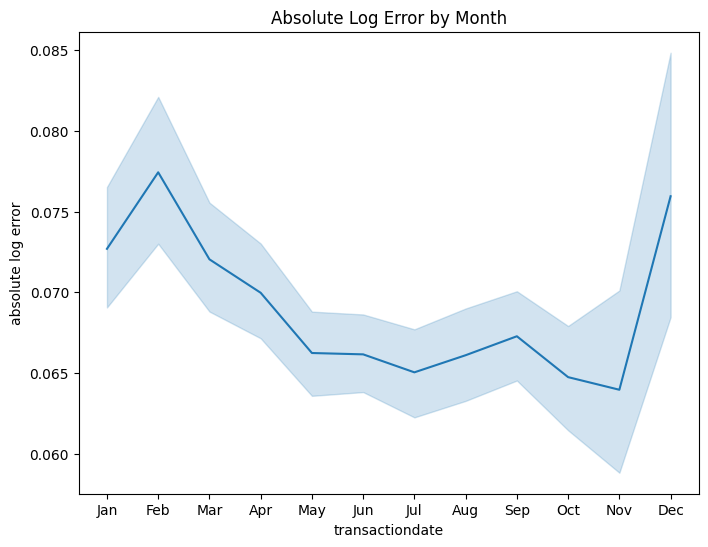

In [9]:
# Absolute logerror over time
plt.figure(figsize=(8,6))
g = sns.lineplot(x=df16.transactiondate.dt.month, y=abs(df16.logerror.values))
plt.xticks(range(1,13))
g.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.ylabel('absolute log error')
plt.title('Absolute Log Error by Month')
plt.show()

Log Error is highest in the winter months. This is typically the slow season of house sales, so it makes that predictions are harder. There are fewer comparable transactions.

# Examine transactions per month

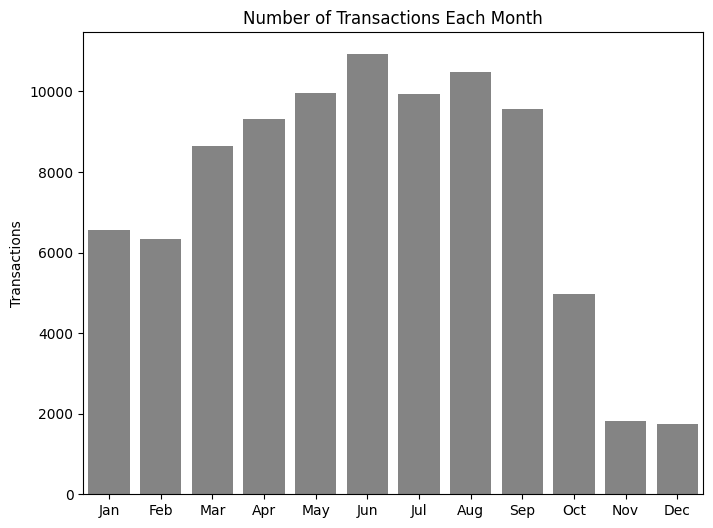

In [10]:
# Number of transactions over time
plt.figure(figsize=(8,6))
x= df16.transaction_month.value_counts().index
y= df16.transaction_month.value_counts()
g = sns.barplot(x=x, y=y, alpha =0.8, color='0.4')
plt.xticks(range(0,12))
g.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.ylabel('Transactions')
plt.title('Number of Transactions Each Month')
plt.show()

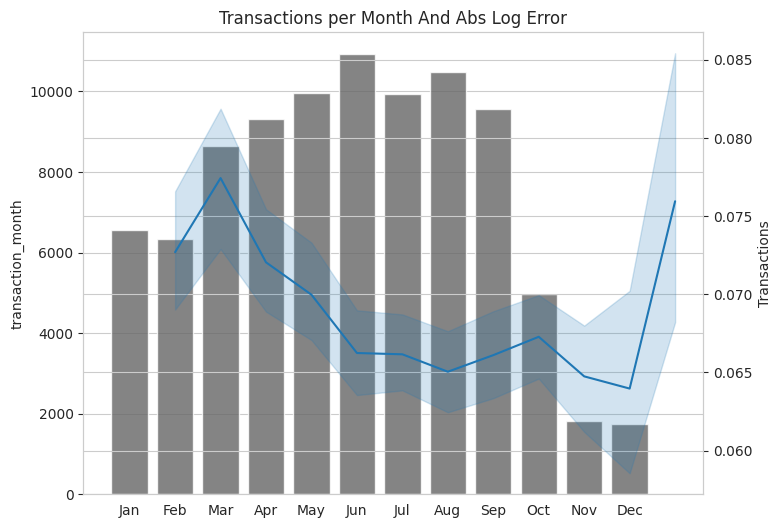

In [150]:
# Log Error vs Transactions
plt.figure(figsize=(8,6))
x= df16.transaction_month.value_counts().index
y= df16.transaction_month.value_counts()
ax1 = sns.barplot(x=x, y=y, alpha =0.8, color='0.4')
ax2 = ax1.twinx()
sns.lineplot(x=df16.transactiondate.dt.month, y=abs(df16.logerror.values), ax=ax2)
plt.xticks(range(12))
ax1.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.ylabel('Transactions')
plt.title('Transactions per Month And Abs Log Error')
plt.show()

In [12]:
df16.columns

Index(['Unnamed: 0', 'parcelid', 'logerror', 'transactiondate',
       'transaction_year', 'transaction_month', 'transaction_day',
       'transaction_quarter', 'aircon', 'architecture', 'basementsqft',
       'bathroomcnt', 'bedroomcnt', 'framing', 'quality', 'calculatedbathnbr',
       'deck', 'entry_floor_sqft', 'home_sqft', 'living_sqft',
       'perimeter_sqft', 'total_sqft', 'base_sqft', 'fips', 'fireplacecnt',
       'fullbathcnt', 'garagecarcnt', 'garage_sqft', 'has_spa', 'heating',
       'latitude', 'longitude', 'lot_sqft', 'poolcnt', 'poolsizesum',
       'pool_with_spa', 'pool_without_spa', 'land_use_code',
       'county_land_use_code', 'zoning_code', 'rawcensustractandblock', 'city',
       'county', 'neighborhood', 'zipcode', 'roomcnt', 'storytypeid',
       'threequarterbathnbr', 'material', 'unitcnt', 'patio_sqft', 'shed_sqft',
       'yearbuilt', 'numberofstories', 'fireplaceflag', 'tav_built',
       'tax_assessed_value', 'assessmentyear', 'tav_land', 'property_tax',

In [13]:
# create categories for bad overestimates, bad underestimates, and in between
float_cols = [col for col in df16.columns if col not in ['logerror'] if df16[col].dtype=='float64']
float_cols

['aircon',
 'architecture',
 'basementsqft',
 'bathroomcnt',
 'bedroomcnt',
 'framing',
 'quality',
 'calculatedbathnbr',
 'deck',
 'entry_floor_sqft',
 'home_sqft',
 'living_sqft',
 'perimeter_sqft',
 'total_sqft',
 'base_sqft',
 'fips',
 'fireplacecnt',
 'fullbathcnt',
 'garagecarcnt',
 'garage_sqft',
 'has_spa',
 'heating',
 'latitude',
 'longitude',
 'lot_sqft',
 'poolcnt',
 'poolsizesum',
 'pool_with_spa',
 'pool_without_spa',
 'county_land_use_code',
 'rawcensustractandblock',
 'city',
 'county',
 'neighborhood',
 'zipcode',
 'roomcnt',
 'storytypeid',
 'threequarterbathnbr',
 'material',
 'unitcnt',
 'patio_sqft',
 'shed_sqft',
 'yearbuilt',
 'numberofstories',
 'fireplaceflag',
 'tav_built',
 'tax_assessed_value',
 'assessmentyear',
 'tav_land',
 'property_tax',
 'taxdelinquencyflag',
 'taxdelinquencyyear',
 'censustractandblock']

In [15]:
# Correlation with absolute log error
corr_dict = {}
for col in float_cols:
  corr_dict[col] = abs(df16['logerror']).corr(df16[col])
corr_df = pd.DataFrame(corr_dict.items(), columns = ['Feature','Corr to Abs Log'])
print(corr_df)

                   Feature  Corr to Abs Log
0                   aircon        -0.019624
1             architecture         0.006027
2             basementsqft         0.212579
3              bathroomcnt        -0.006541
4               bedroomcnt         0.001220
5                  framing              NaN
6                  quality         0.059824
7        calculatedbathnbr         0.009510
8                     deck              NaN
9         entry_floor_sqft         0.030578
10               home_sqft         0.039368
11             living_sqft         0.026750
12          perimeter_sqft         0.129071
13              total_sqft         0.045420
14               base_sqft        -0.108821
15                    fips        -0.039231
16            fireplacecnt         0.037403
17             fullbathcnt         0.017007
18            garagecarcnt         0.014928
19             garage_sqft         0.029417
20                 has_spa              NaN
21                 heating      

In [16]:
print('Max:', corr_df.max())
print('Min:', corr_df.min())

Max: Feature             zipcode
Corr to Abs Log    0.212579
dtype: object
Min: Feature             aircon
Corr to Abs Log   -0.11585
dtype: object


<ipython-input-54-f96e1e9f2ab0>:2: FutureWarning: The default value of numeric_only in DataFrame.corrwith is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df16.corrwith(abs(df16['logerror']))
<ipython-input-54-f96e1e9f2ab0>:7: FutureWarning: The default value of numeric_only in DataFrame.corrwith is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_df = df16.drop(excluded_cols, axis=1).corrwith(abs(df16['logerror']))


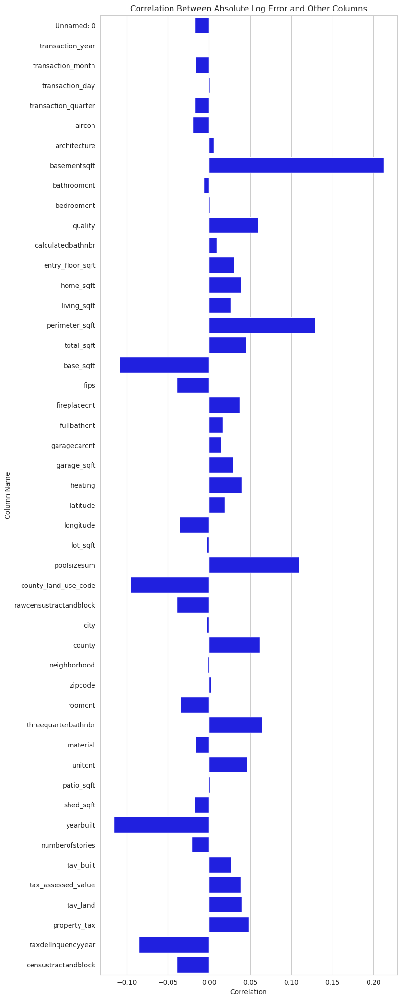

In [54]:
# Calculate correlation matrix and convert to dataframe
excluded_cols = ['logerror', 'parcelid', 'framing', 'deck', 'has_spa', 'poolcnt','pool_with_spa',
                 'pool_without_spa','storytypeid','fireplaceflag','assessmentyear','taxdelinquencyflag']
corr_df = df16.drop(excluded_cols, axis=1).corrwith(abs(df16['logerror']))
corr_df = pd.DataFrame(corr_df, columns=['correlation'])

# Create horizontal barplot using Seaborn
plt.figure(figsize=(8,26))
sns.set_style('whitegrid')
barplot = sns.barplot(x='correlation', y=corr_df.index, data=corr_df, color='blue')

# Add labels and title
plt.xlabel('Correlation')
plt.ylabel('Column Name')
plt.title('Correlation Between Absolute Log Error and Other Columns')

plt.show()

In [130]:
# Things to plot vs log error
medium_corr = corr_df[(abs(corr_df['correlation']) > 0.05) & (abs(corr_df['correlation']) < 0.1)]
higher_corr = corr_df[abs(corr_df['correlation'])>0.10]
print('Medium Corr with Abs Log Error')
print(medium_corr.sort_values('correlation'))
print()
print('Higher Corr with Abs Log Error')
print(higher_corr.sort_values('correlation'))

Medium Corr with Abs Log Error
                      correlation
county_land_use_code    -0.095566
taxdelinquencyyear      -0.084973
quality                  0.059824
county                   0.061964
threequarterbathnbr      0.064325

Higher Corr with Abs Log Error
                correlation
yearbuilt         -0.115850
base_sqft         -0.108821
poolsizesum        0.109684
perimeter_sqft     0.129071
basementsqft       0.212579


# Plot high corr features vs log error

In [165]:
# Function for scatter plots vs logerror
def scatter_list(list):
  list = list
  fig, ax =plt.subplots(1,len(list), figsize=(12,4))
  for i in range(len(list)):
    sns.scatterplot(data=df16, x=list[i], y='logerror', ax=ax[i])
    plt.ylabel('Abs Log Error')
  plt.show()

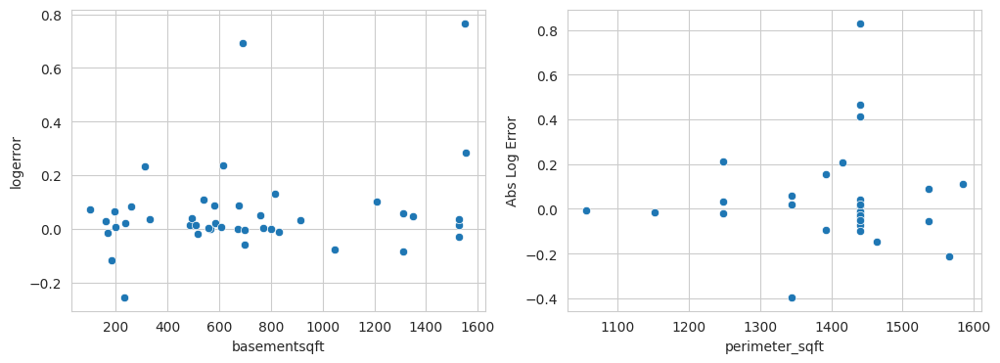

In [166]:
# Basement SqFt and Perimeter SqFt
scatter_list(['basementsqft', 'perimeter_sqft'])

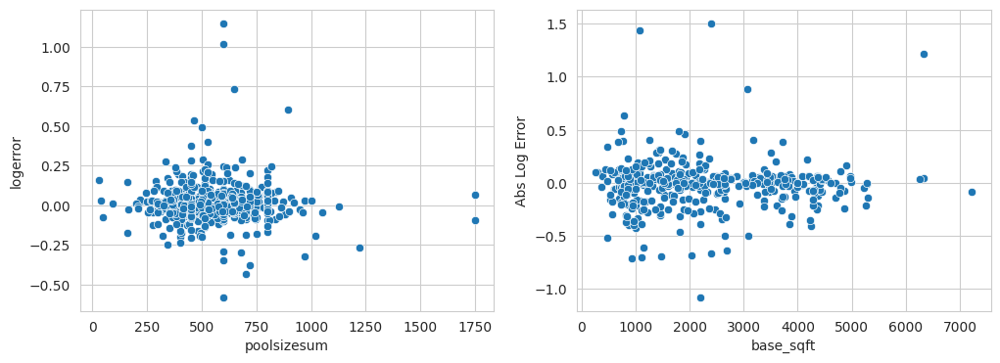

In [168]:
# Pool size and Base SqFt
scatter_list(['poolsizesum', 'base_sqft'])

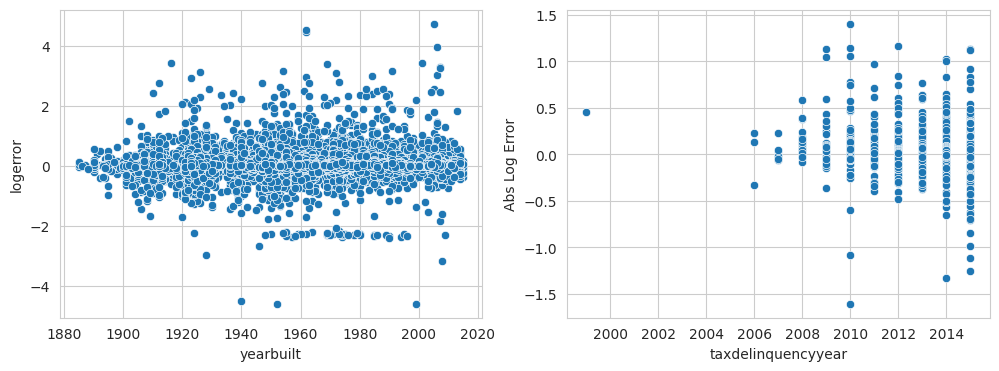

In [170]:
scatter_list(['yearbuilt','taxdelinquencyyear'])

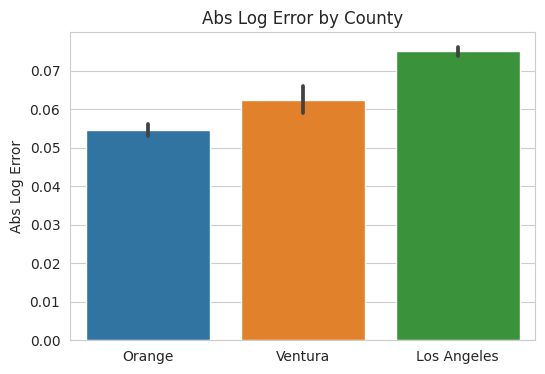

In [178]:
# Log Error vs County
# county 2061 = Ventura
# county 1286 = Orange
# county 31031 = Los Angeles
plt.figure(figsize=(6,4))
x= df16.county
y= abs(df16.logerror)
ax1 = sns.barplot(x=x, y=y)
plt.ylabel('Abs Log Error')
ax1.set_xticklabels(['Orange','Ventura','Los Angeles'])
plt.xlabel('')
plt.title('Abs Log Error by County')
plt.show()

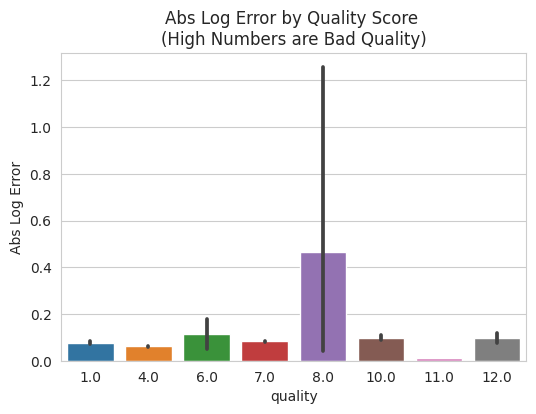

In [186]:
# Log Error vs Quality
# It appears "8" is a very common rating for quality and is not very helpful for the Zestimate
plt.figure(figsize=(6,4))
x= df16.quality
y= abs(df16.logerror)
ax1 = sns.barplot(x=x, y=y)
plt.ylabel('Abs Log Error')
plt.title('Abs Log Error by Quality Score \n(High Numbers are Bad Quality)')
plt.show()

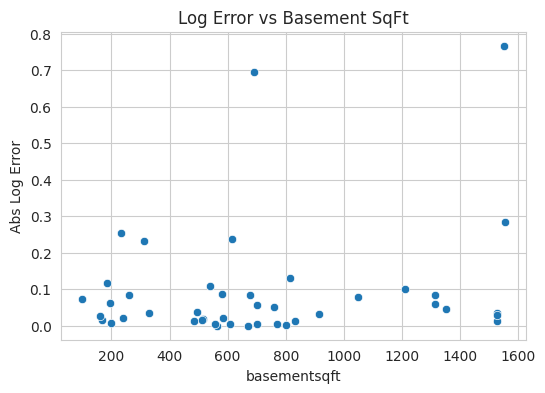

In [156]:
# Log Error vs Basement Square Footage
plt.figure(figsize=(6,4))
x= df16.basementsqft
y= abs(df16.logerror)
ax1 = sns.scatterplot(x=x, y=y)
plt.ylabel('Abs Log Error')
plt.show()

# Plot historgrames of numerical features

In [56]:
# create function to speed up plotting
def hist_list(list, bins):
  list = list
  fig, ax =plt.subplots(1,len(list), figsize=(20,4))
  for i in range(len(list)):
    sns.histplot(data=df16, x=list[i], ax=ax[i], bins = bins)
  plt.show()

In [147]:
bool_cols = ['has_spa', 'pool_with_spa', 'pool_without_spa', 'fireplaceflag', 'taxdelinquencyflag']

cat_cols = ['aircon', 'architecture', 'framing', 'quality', 'deck',
            'fips', 'heating', 'latitude', 'longitude', 'rawcensustractandblock', 
            'city', 'county', 'neighborhood', 'zipcode', 'storytypeid', 
            'material', 'unitcnt', 'numberofstories', 'assessmentyear',
            'taxdelinquencyyear', 'censustractandblock']

num_cols = ['basementsqft', 'bathroomcnt', 'bedroomcnt', 'calculatedbathnbr', 
            'entry_floor_sqft', 'home_sqft', 'living_sqft', 'perimeter_sqft', 
            'total_sqft', 'base_sqft', 'fireplacecnt', 'fullbathcnt', 
            'garagecarcnt', 'garage_sqft', 'lot_sqft', 'poolcnt', 'poolsizesum',
            'roomcnt', 'threequarterbathnbr', 'unitcnt', 'patio_sqft', 'shed_sqft',
            'yearbuilt', 'numberofstories', 'tav_built', 'tax_assessed_value', 
            'assessmentyear', 'tav_land', 'property_tax','taxdelinquencyyear']

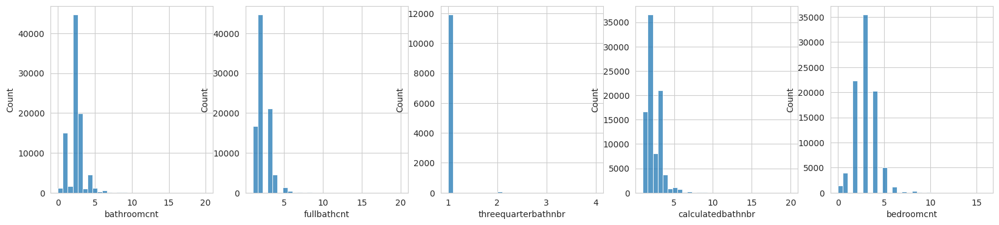

In [81]:
# Histograms of bedroom and bath info
# 'bathroomcnt', 'fullbathcnt', 'threequarterbathnbr', 'calculatedbathnbr', 'bedroomcnt'
hist_list(['bathroomcnt', 'fullbathcnt', 'threequarterbathnbr', 'calculatedbathnbr', 'bedroomcnt'], 30)

In [36]:
print('Value counts for # of 3/4 baths: \n', df16['threequarterbathnbr'].value_counts())
# description from data dictionary:  "Number of 3/4 bathrooms in house (shower + sink + toilet)""

Value counts for # of 3/4 baths: 
 1.0    11912
2.0       90
3.0        6
4.0        1
Name: threequarterbathnbr, dtype: int64


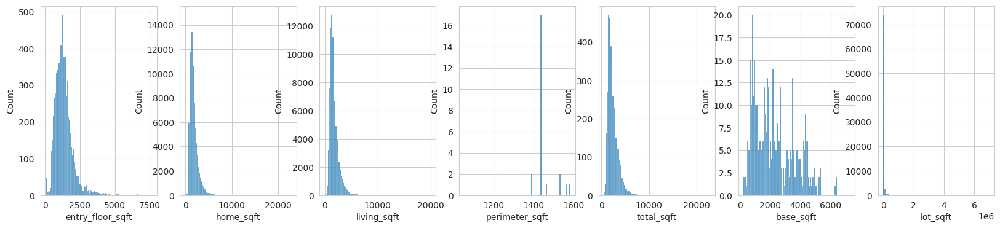

In [62]:
# Histograms of square footage info
# 'entry_floor_sqft', 'home_sqft', 'living_sqft', 'perimeter_sqft', 'total_sqft', 'base_sqft', 'lot_sqft'
hist_list(['entry_floor_sqft', 'home_sqft', 'living_sqft', 'perimeter_sqft', 'total_sqft', 'base_sqft', 'lot_sqft'], 100)

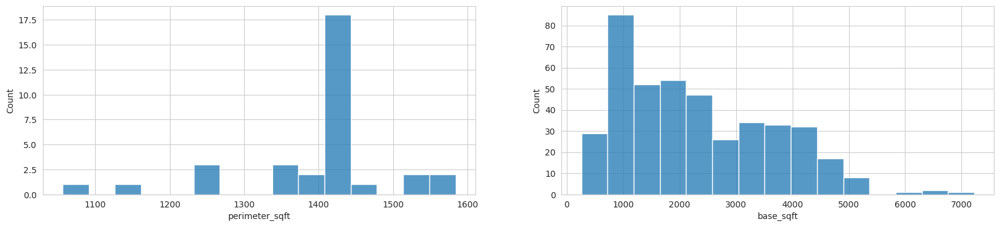

In [67]:
hist_list(['perimeter_sqft', 'base_sqft'],15)

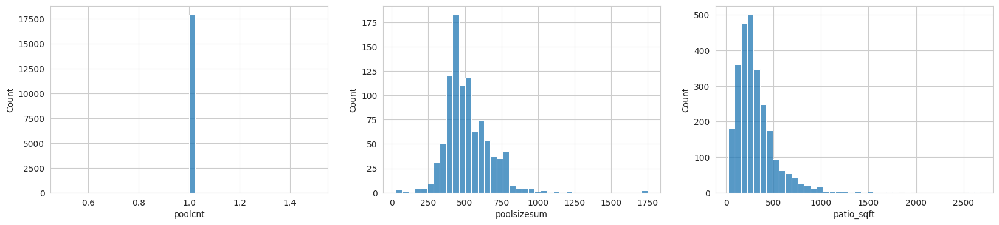

In [73]:
# Histograms of pool and patio details
# 'poolcnt', 'poolsizesum', 'patio_sqft'
hist_list(['poolcnt', 'poolsizesum', 'patio_sqft'], 40)

In [79]:
print('Every "poolcnt" entry is 1.')
print(df16['poolcnt'].value_counts())

Every "poolcnt" entry is 1.
1.0    17901
Name: poolcnt, dtype: int64


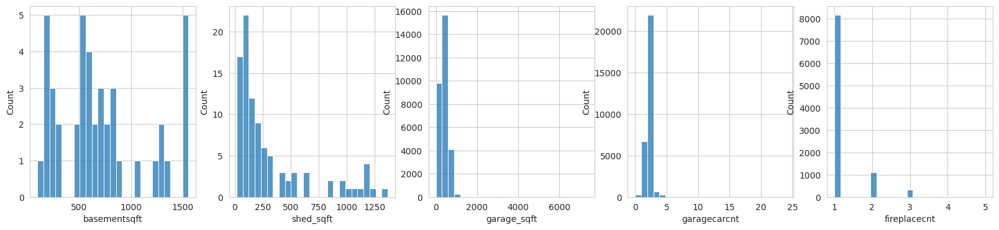

In [84]:
# Histograms of garage, shed, basement, and fireplace details
# 'basementsqft', 'shed_sqft', 'garage_sqft', 'garagecarcnt', 'fireplacecnt'
hist_list(['basementsqft', 'shed_sqft', 'garage_sqft', 'garagecarcnt', 'fireplacecnt'],25) 

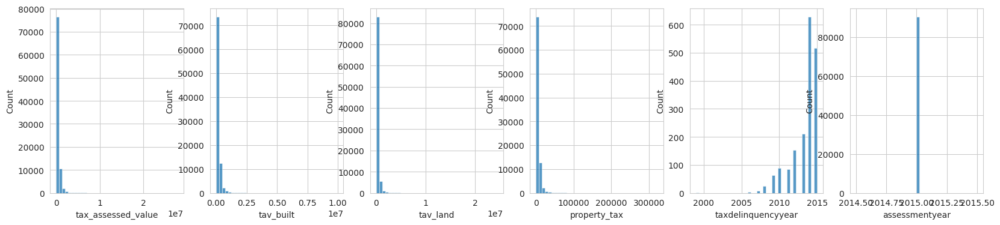

In [86]:
# Histograms of tax details
# 'tax_assessed_value', 'tav_built', 'tav_land', 'property_tax','taxdelinquencyyear', 'assessmentyear'
hist_list(['tax_assessed_value', 'tav_built', 'tav_land', 'property_tax','taxdelinquencyyear', 'assessmentyear'],40)

In [97]:
print("TAV min:", df16.tax_assessed_value.min())
print("TAV median:", df16.tax_assessed_value.median())
print("TAV mean:", round(df16.tax_assessed_value.mean(), 1))
print("TAV max:", df16.tax_assessed_value.max())

TAV min: 22.0
TAV median: 342872.0
TAV mean: 457672.6
TAV max: 27750000.0


In [103]:
# Why would two properties have a TAV of 22?
df16[df16['tax_assessed_value']<=10000].sort_values('tax_assessed_value')

,Unnamed: 0,parcelid,logerror,transactiondate,transaction_year,transaction_month,transaction_day,transaction_quarter,aircon,architecture,...,numberofstories,fireplaceflag,tav_built,tax_assessed_value,assessmentyear,tav_land,property_tax,taxdelinquencyflag,taxdelinquencyyear,censustractandblock
16045,16045,12566319,-0.0263,2016-03-14,2016,3,14,1,NaN,NaN,...,NaN,NaN,NaN,22.0,2015.0,22.0,1556.26,NaN,NaN,NaN
25390,25390,12431927,-0.0715,2016-04-14,2016,4,14,2,NaN,NaN,...,NaN,NaN,NaN,22.0,2015.0,22.0,2409.92,NaN,NaN,6.037555e+13
12176,12176,11524235,2.5440,2016-02-26,2016,2,26,1,NaN,NaN,...,NaN,NaN,104.0,1044.0,2015.0,940.0,64.00,NaN,NaN,6.037276e+13
13388,13388,14355387,0.0516,2016-03-02,2016,3,2,1,NaN,NaN,...,NaN,NaN,NaN,1928.0,2015.0,1928.0,14010.90,NaN,NaN,NaN
79750,79750,14355872,0.0247,2016-09-27,2016,9,27,3,NaN,NaN,...,NaN,NaN,NaN,2675.0,2015.0,2675.0,17624.44,NaN,NaN,6.059052e+13
88869,88869,12272795,0.0611,2016-12-07,2016,12,7,4,NaN,NaN,...,NaN,NaN,4667.0,7704.0,2015.0,3037.0,661.12,1.0,2015.0,6.037542e+13
28207,28207,14646864,0.1898,2016-04-22,2016,4,22,2,1.0,NaN,...,1.0,NaN,3918.0,7837.0,2015.0,3919.0,96.74,NaN,NaN,6.059063e+13
56347,56347,12231898,0.2654,2016-07-15,2016,7,15,3,NaN,NaN,...,NaN,NaN,3448.0,8314.0,2015.0,4866.0,348.89,NaN,NaN,6.037243e+13
6709,6709,14506872,0.7343,2016-02-01,2016,2,1,1,NaN,NaN,...,1.0,NaN,3286.0,8629.0,2015.0,5343.0,108.98,NaN,NaN,6.059032e+13
62877,62877,11377029,1.3790,2016-08-03,2016,8,3,3,NaN,NaN,...,NaN,NaN,113.0,9271.0,2015.0,9158.0,244.11,NaN,NaN,6.037900e+13


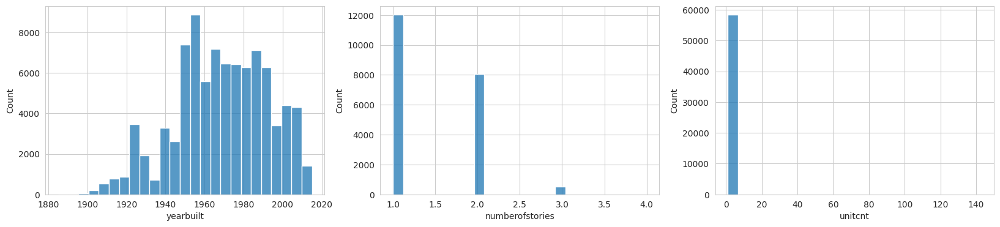

In [131]:
# Other histograms
# 'yearbuilt', 'numberofstories'
hist_list(['yearbuilt', 'numberofstories', 'unitcnt'],25)

In [107]:
df16.unitcnt.value_counts()

1.0      54503
2.0       2354
4.0        871
3.0        619
6.0          1
143.0        1
11.0         1
9.0          1
5.0          1
70.0         1
Name: unitcnt, dtype: int64

# Plot boxplots of boolean features vs Log Error

In [136]:
bool_cols

['has_spa',
 'spa_or_hot_tub',
 'pool_with_spa',
 'pool_without_spa',
 'fireplaceflag',
 'taxdeliquencyflag']

In [143]:
# create function to speed up plotting
def boxplot_list(df, list):
  list = list
  fig, ax =plt.subplots(1,len(list), figsize=(20,4))
  for i in range(len(list)):
    sns.boxplot(data=df, y=df16.logerror, x=list[i], ax=ax[i]).set_title(list[i])
  plt.show()

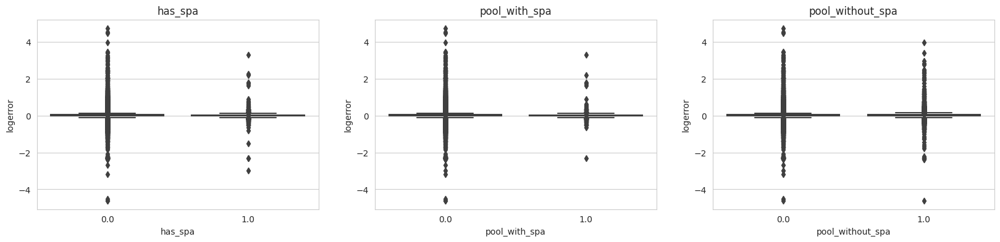

In [144]:
# Examine logerror versus pool data if NaNs = 0
df_pool_no_nulls = df16[['has_spa', 'pool_with_spa','pool_without_spa']].fillna(0)
boxplot_list(df_pool_no_nulls, ['has_spa', 'pool_with_spa','pool_without_spa'])

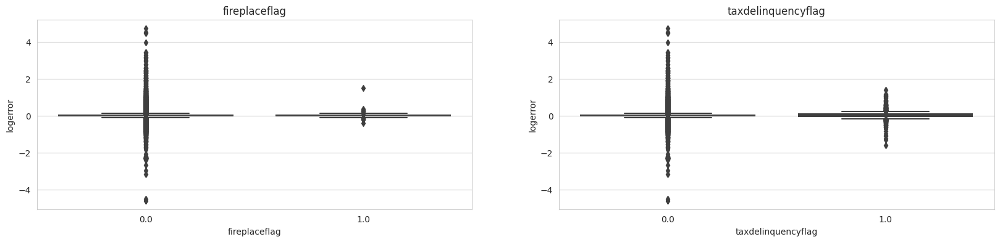

In [149]:
# Examine logerror versus other boolean data if NaNs = 0
df_flag_no_nulls = df16[['fireplaceflag','taxdelinquencyflag']].fillna(0)
boxplot_list(df_flag_no_nulls, ['fireplaceflag','taxdelinquencyflag'])

The True cases of the boolean features seem to greatly reduce log error.

# Log Error vs Geography

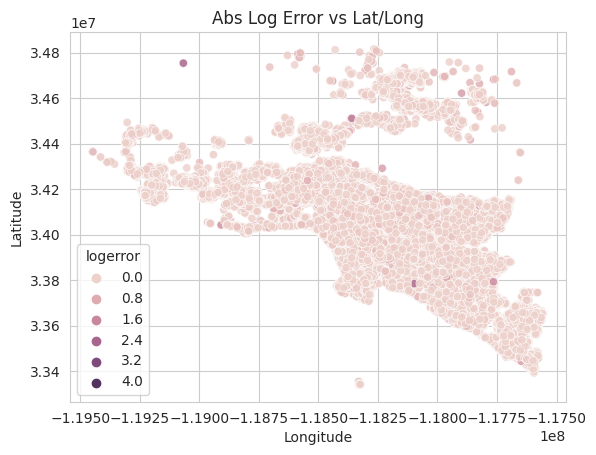

In [197]:
# Plot latitude and longitude data
x, y = df16['longitude'], df16['latitude']
sns.scatterplot(x=x, y=y, color='red', alpha=0.8, hue=abs(df16.logerror))

# Set plot title and axis labels
plt.title('Abs Log Error vs Lat/Long')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show plot
plt.show()

In [199]:
# Create a latitutde longitude dataset for tableau
tab16 = df16[['logerror','latitude','longitude']]
tab16['abslogerror'] =abs(tab16.logerror)
tab16.dropna(inplace=True)
tab16 = tab16.sample(frac=0.2, random_state = 1)
from google.colab import files
tab16.to_csv('tab16.csv', encoding = 'utf-8-sig') 
files.download('tab16.csv')

There is not an obvious association between geography and logerror.